<a href="https://colab.research.google.com/github/MauriJ/Visualizacion_Bancor/blob/main/Clase%202/Clase_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Unidad 4. Herramientas para la visualización de datos. Academia Data Driven.

## Clase N°2

### Docente: [Mauricio Morán](www.linkedin.com/in/mauricio-moran)

En la clase pasada (Clase 1) empezamos a ver Matplotlib, aprendimos la sintaxis básica de esta librería. Empezamos a hacer varios tipos de gráficos y los personalizamos aplicando varios métodos.

En la clase de hoy veremos los métodos auxiliares de Pandas y veremos el paquete para visualización Seaborn.

Y ahora importemos los paquetes

In [1]:
# Paquetes para manipulación de datos
import numpy as np
import pandas as pd

# Paquetes para visualización y armado de gráficos
import matplotlib.pyplot as plt
import seaborn as sns

Importemos el mismo dataset que usamos en la clase pasada

In [2]:
credito_path = 'https://raw.githubusercontent.com/MauriJ/Visualizacion_Bancor/main/Datasets/credit_risk_dataset.csv'
df_credito = pd.read_csv(credito_path)
df_credito.head()

,person_age,person_income,person_home_ownership,person_emp_length,loan_intent,loan_grade,loan_amnt,loan_int_rate,loan_status,loan_percent_income,cb_person_default_on_file,cb_person_cred_hist_length
0,22,59000,RENT,123.0,PERSONAL,D,35000,16.02,1,0.59,Y,3
1,21,9600,OWN,5.0,EDUCATION,B,1000,11.14,0,0.10,N,2
2,25,9600,MORTGAGE,1.0,MEDICAL,C,5500,12.87,1,0.57,N,3
3,23,65500,RENT,4.0,MEDICAL,C,35000,15.23,1,0.53,N,2
4,24,54400,RENT,8.0,MEDICAL,C,35000,14.27,1,0.55,Y,4


Renombremos las columnas para que exhiban nombre en español.

In [3]:
df_credito.columns = ['Edad',
                       'Ingresos',
                       'Situacion de vivienda',
                       'Tiempo de empleo',
                       'Tipo de préstamo',
                       'Grado del préstamo',
                       'Monto del préstamo',
                       'Tasa de interés',
                       'Estado del préstamo',
                       'Porcentaje del Ingreso',
                       'Default histórico',
                       'Long. historial crediticio']

df_credito.head()

,Edad,Ingresos,Situacion de vivienda,Tiempo de empleo,Tipo de préstamo,Grado del préstamo,Monto del préstamo,Tasa de interés,Estado del préstamo,Porcentaje del Ingreso,Default histórico,Long. historial crediticio
0,22,59000,RENT,123.0,PERSONAL,D,35000,16.02,1,0.59,Y,3
1,21,9600,OWN,5.0,EDUCATION,B,1000,11.14,0,0.10,N,2
2,25,9600,MORTGAGE,1.0,MEDICAL,C,5500,12.87,1,0.57,N,3
3,23,65500,RENT,4.0,MEDICAL,C,35000,15.23,1,0.53,N,2
4,24,54400,RENT,8.0,MEDICAL,C,35000,14.27,1,0.55,Y,4


Antes de proseguir, nos va a ser muy útil inspeccionar que tipos de datos tiene este dataframe. Para ellos es muy conveniente el método info().

In [4]:
df_credito.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32581 entries, 0 to 32580
Data columns (total 12 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Edad                        32581 non-null  int64  
 1   Ingresos                    32581 non-null  int64  
 2   Situacion de vivienda       32581 non-null  object 
 3   Tiempo de empleo            31686 non-null  float64
 4   Tipo de préstamo            32581 non-null  object 
 5   Grado del préstamo          32581 non-null  object 
 6   Monto del préstamo          32581 non-null  int64  
 7   Tasa de interés             29465 non-null  float64
 8   Estado del préstamo         32581 non-null  int64  
 9   Porcentaje del Ingreso      32581 non-null  float64
 10  Default histórico           32581 non-null  object 
 11  Long. historial crediticio  32581 non-null  int64  
dtypes: float64(3), int64(5), object(4)
memory usage: 3.0+ MB


### Métodos auxiliares de Pandas

Pandas incorpora a la libreria Matplotlib, haciendo que graficar los datos alojados en dataframes sea más sencillo, simplificando líneas de código. El método base es plot(), este se aplica haciendo df.plot(), dónde "df" es el nombre del dataset que se quiere grafica, en nuestro caso es df_credito.

#### Gráficos de linea

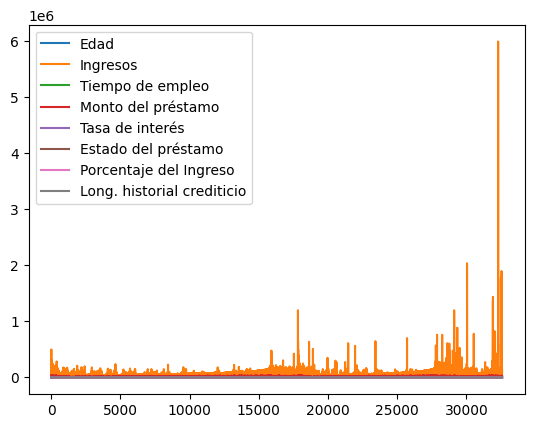

In [5]:
df_credito.plot()
plt.show()

Como vemos plot() grafica indiscriminadamente todas las columnas numéricas. Para este dataset no es muy útil. Veamos cómo graficar algunas variables que querramos. Hagamos un gráfico univariado (de una variable), de tres maneras:

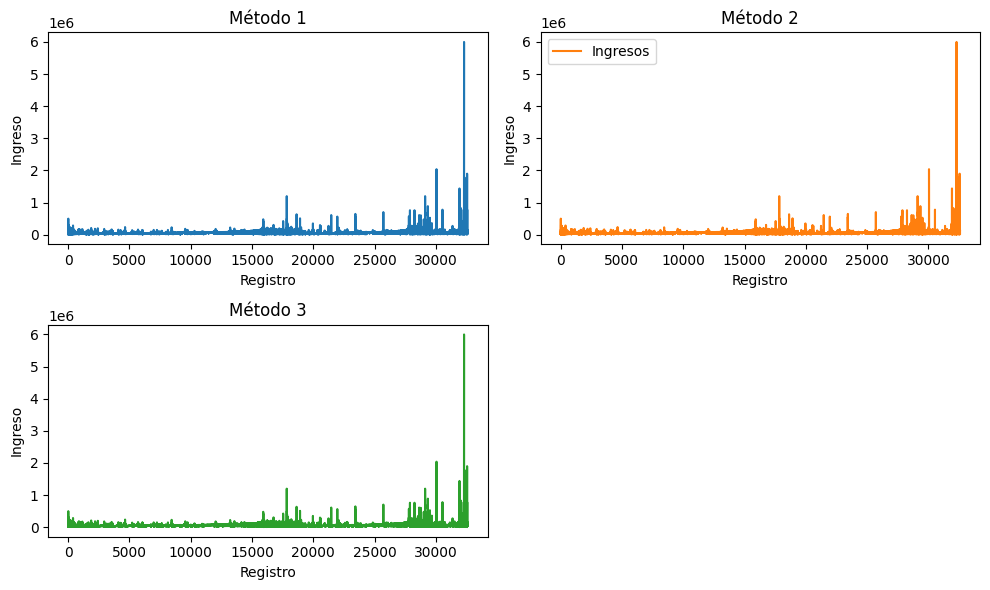

In [6]:
fig, axes = plt.subplots(2, 2, figsize = (10, 6))

# Metodo 1
df_credito['Ingresos'].plot(ax = axes[0, 0], color = 'C0')

# Metodo 2
df_credito.plot(y = 'Ingresos', ax = axes[0, 1], color = 'C1')

# Metodo 3
df_credito.Ingresos.plot(ax = axes[1, 0], color = 'C2')

idx = 1

for columna in [0, 1]:
  for fila in [0, 1]:
    axes[columna, fila].set_xlabel('Registro')
    axes[columna, fila].set_ylabel('Ingreso')
    axes[columna, fila].set_title(f'Método {idx}')
    idx += 1

axes[1, 1].remove()

plt.tight_layout()
plt.show()

#### Gráficos de puntos

Y un gráfico bivariado (de dos variables):

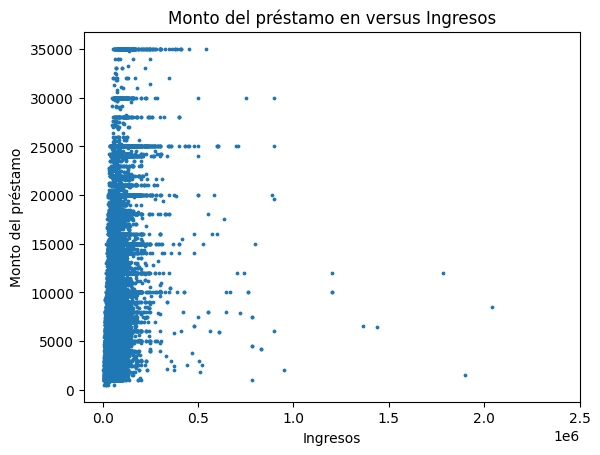

In [7]:
df_credito.plot(x = 'Ingresos', y = 'Monto del préstamo', kind = 'scatter', s = 3)
plt.xlim(-100000, 2500000)
plt.title('Monto del préstamo en versus Ingresos')
plt.show()

En el gráfico anterior podemos notar dos aspectos importantes. El primero, podemos modificar el tipo de gráfico pasando el parámetro kind. Según la documentación de Pandas, disponemos de estas opciones:

* ‘line’ : gráfico de línea (default).
* ‘bar’ : gráfico de barras verticales.
* ‘barh’ : gráficos de barras horizontales.
* ‘hist’ : histograma.
* ‘box’ : gráfico de caja.
* ‘kde’ : gráfico kde.
* ‘density’ : lo mismo que ‘kde’.
* ‘area’ : gráfico de área.
* ‘pie’ : gráfico de torta.
* ‘scatter’ : gráfico de puntos.
* ‘hexbin’ : gráfico de grilla hexagonal.

Segundo, los métodos de personalización que vimos en la clase pasada se aplican de idéntica manera. Observen que aplicamos plt.xlim() y plt.title() como lo veníamos haciendo.

También podemos indicar que tipo gráfico directamente en el nómbre del método, por ejemplo: df_credito.plot.scatter(). Además si pasamos el parámetro c y se lo asignamos a una variable numérica obtenemos esto:

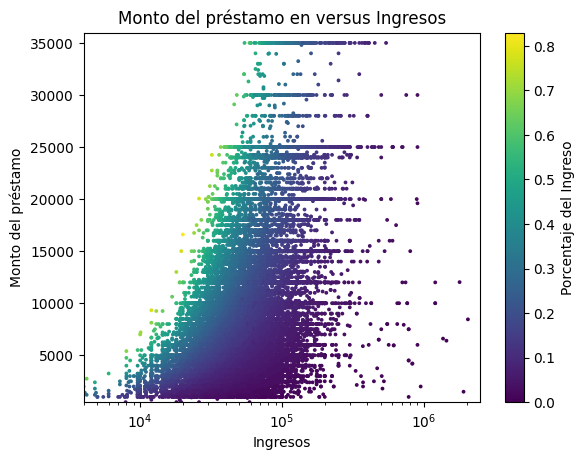

In [8]:
df_credito.plot.scatter(x = 'Ingresos', y = 'Monto del préstamo', c = 'Porcentaje del Ingreso', s = 3)

plt.xscale('log')

plt.xlim(4000, 2500000)
plt.ylim(500, 36000)

plt.title('Monto del préstamo en versus Ingresos')
plt.show()

También podemos pasar una variable categórica como el parámetro c.

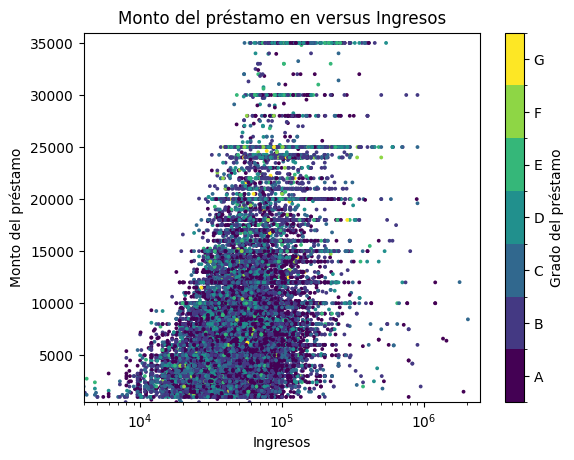

In [9]:
df_credito['Grado del préstamo'] = pd.Categorical(df_credito['Grado del préstamo'])

df_credito.plot.scatter(x = 'Ingresos', y = 'Monto del préstamo', c = 'Grado del préstamo', cmap="viridis", s = 3)

plt.xscale('log')

plt.xlim(4000, 2500000)
plt.ylim(500, 36000)

plt.title('Monto del préstamo en versus Ingresos')
plt.show()

#### Histogramas / graficos de densidad

Probemos ahora a graficar histogramas y gráficos de densidad (también llamados kde) y comparémoslos.

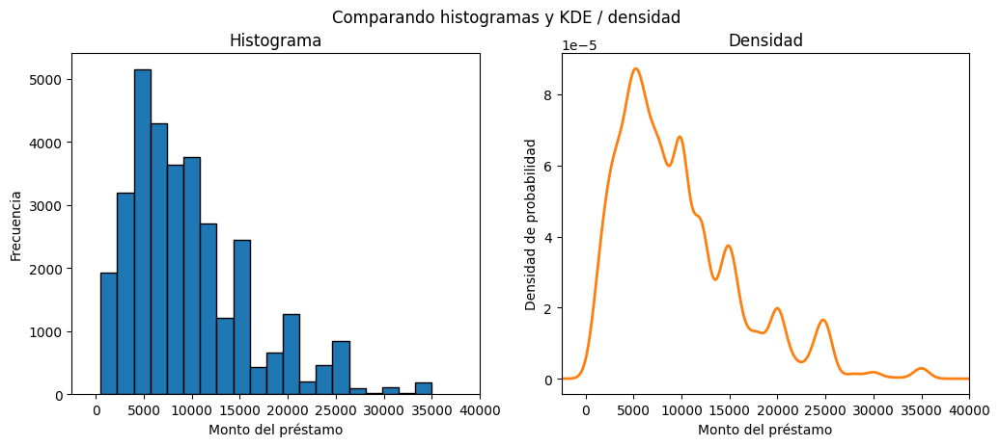

In [10]:
plt.figure(figsize = (12, 4.6))

plt.suptitle('Comparando histogramas y KDE / densidad')

plt.subplot(121)

df_credito['Monto del préstamo'].plot.hist(bins = 20, edgecolor='black')

plt.xlabel('Monto del préstamo')
plt.ylabel('Frecuencia')
plt.title('Histograma')

plt.xlim(-2500, 40000)

plt.subplot(122)

df_credito['Monto del préstamo'].plot.kde(linewidth = 2, color = 'C1')

plt.xlabel('Monto del préstamo')
plt.ylabel('Densidad de probabilidad')
plt.title('Densidad')

plt.xlim(-2500, 40000)

plt.show()

Vemos que la sinergia entre Pandas y Matplotlib nos permite graficar rápidamente y más convenientemente las distintas variables en un dataset. Hay varios gráficos que podemos hacer, vimos un par de ellos, dejo el resto para que prueben y practiquen!

Si aplicamos hacemos simplemente df_credito.hist() graficamos rápidamente histogramas de todas las variables numéricas del dataset. Esto es extremadamente útil para el análisis exploratorio.

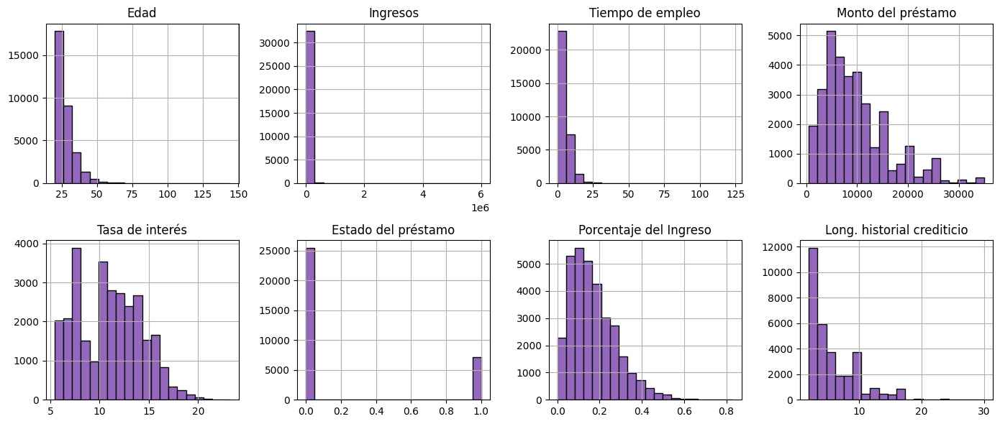

In [11]:
df_credito.hist(bins = 20, figsize = (14, 6), layout = (2, 4), edgecolor = 'k', color = 'C4')
plt.tight_layout()
plt.show()

#### Scatter matrix

Otro método de Pandas muy potente para el análisis exploratorio es scatter_matrix, el cual hace gráficos de puntos entre todas las combinaciones posibles de variables numéricas en el dataset. Además, grafica histogramas de cada una de las mencionadas variables. Este método puede llegar a ser muy lento en dataframes muy grandes por lo que tomaremos una muestra al azar de 250 registros.

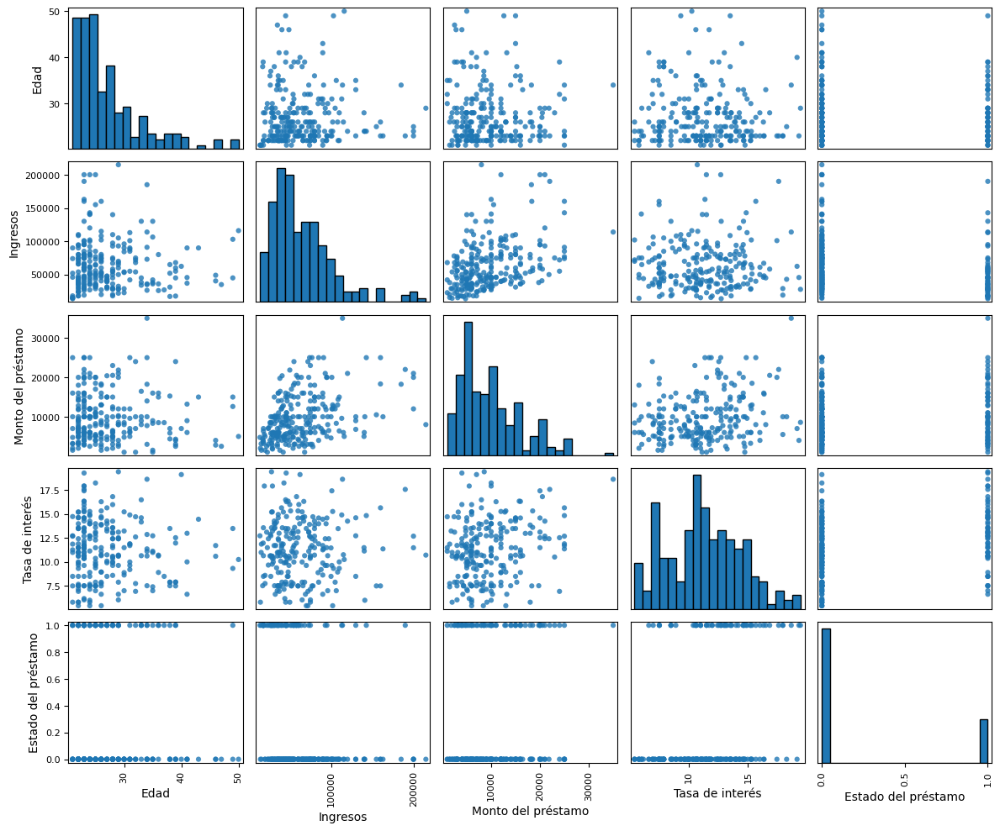

In [12]:
df_credito2 = df_credito[['Edad', 'Ingresos', 'Monto del préstamo', 'Tasa de interés', 'Situacion de vivienda', 'Estado del préstamo', 'Default histórico']].sample(250, random_state = 1)

pd.plotting.scatter_matrix(df_credito2, figsize=(12, 10), marker='o', hist_kwds={'bins': 20, 'edgecolor': 'k'}, s = 20, alpha = .8)

plt.tight_layout()
plt.show()

Ahora prosigamos con Seaborn, es una librería para visualizacion de datos, orientado para datos estadísticos. Está basado en Matplotlib, por lo que muchos métodos nos serán familiares, y podemos combinarlo con Pandas para analizar los datasets.

## Seaborn

Antes que nada, Seaborn tiene cargada una interesante lista de datasets para experimentar y hacer gráficos. Usando el método load_dataset se los puede llamar

In [13]:
df_diamantes = sns.load_dataset('diamonds')
df_diamantes.head()

,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75


La lista completa se puede consultar con el método get_dataset_names. Más información de los mismos está disponible en este [enlace](https://github.com/mwaskom/seaborn-data). E información sobre el dataset está en este otro [enlace](https://ggplot2.tidyverse.org/reference/diamonds.html).

In [14]:
sns.get_dataset_names()

['anagrams',
 'anscombe',
 'attention',
 'brain_networks',
 'car_crashes',
 'diamonds',
 'dots',
 'dowjones',
 'exercise',
 'flights',
 'fmri',
 'geyser',
 'glue',
 'healthexp',
 'iris',
 'mpg',
 'penguins',
 'planets',
 'seaice',
 'taxis',
 'tips',
 'titanic']

Traduzcamos el nombre de las columnas.

In [15]:
df_diamantes.columns = ['Quilates',
                       'Corte',
                       'Color',
                       'Claridad',
                       'Profundidad',
                       'Tabla',
                       'Precio',
                       'x',
                       'y',
                       'z']

df_diamantes.head()

,Quilates,Corte,Color,Claridad,Profundidad,Tabla,Precio,x,y,z
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75


In [16]:
df_diamantes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53940 entries, 0 to 53939
Data columns (total 10 columns):
 #   Column       Non-Null Count  Dtype   
---  ------       --------------  -----   
 0   Quilates     53940 non-null  float64 
 1   Corte        53940 non-null  category
 2   Color        53940 non-null  category
 3   Claridad     53940 non-null  category
 4   Profundidad  53940 non-null  float64 
 5   Tabla        53940 non-null  float64 
 6   Precio       53940 non-null  int64   
 7   x            53940 non-null  float64 
 8   y            53940 non-null  float64 
 9   z            53940 non-null  float64 
dtypes: category(3), float64(6), int64(1)
memory usage: 3.0 MB


Es una dataframe grandecito, vamos a elegir al azar unos cuantos registros para no hacer tan cargados los gráficos.

In [17]:
df_diamantes2 = df_diamantes.sample(500)

#### Gráficos de puntos

Empecemos con gráficos de puntos, hagamos dos de ellos. Uno separando segun la calidad del corte, pasando el parámetro hue (muy útil!!) y otro cambiando el markersize en función del precio de los diamantes.

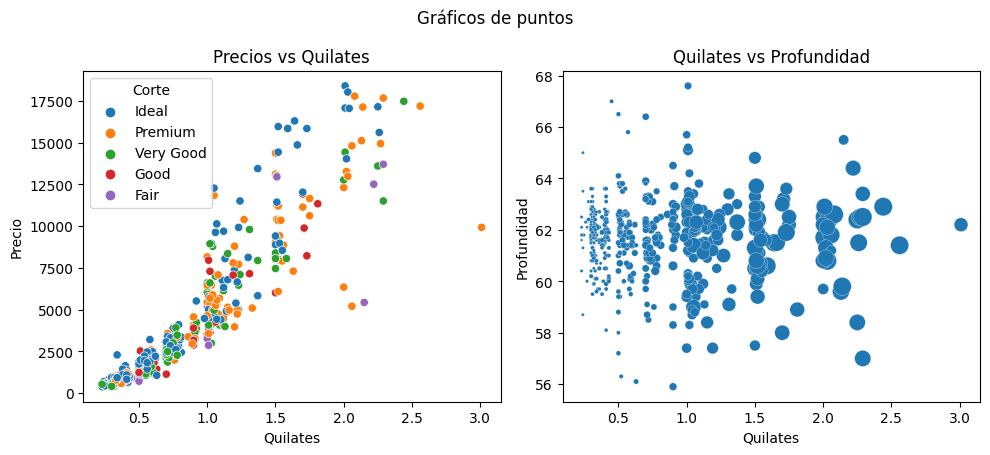

In [18]:
fig, axes = plt.subplots(1, 2, figsize = (10, 4.6))

# Precio vs Quilates
sns.scatterplot(data = df_diamantes2, x = 'Quilates', y = 'Precio', hue = 'Corte', ax = axes[0])

# Quilates vs Profundidad
tamaño = df_diamantes2['Precio']/100
sns.scatterplot(data = df_diamantes2, x = 'Quilates', y = 'Profundidad', s = tamaño, ax = axes[1])

axes[0].set_title('Precios vs Quilates')
axes[1].set_title('Quilates vs Profundidad')

fig.suptitle('Gráficos de puntos')

plt.tight_layout()
plt.show()

### Gráficos de línea

Usemos un dataset diferente para los gráficos de línea. Importemos el dataset Dow Jones.

In [19]:
df_dowjones = sns.load_dataset('dowjones')
df_dowjones.head()

,Date,Price
0,1914-12-01,55.00
1,1915-01-01,56.55
2,1915-02-01,56.00
3,1915-03-01,58.30
4,1915-04-01,66.45


In [20]:
df_dowjones.columns = ['Fecha', 'Precio']

df_dowjones.head()

,Fecha,Precio
0,1914-12-01,55.00
1,1915-01-01,56.55
2,1915-02-01,56.00
3,1915-03-01,58.30
4,1915-04-01,66.45


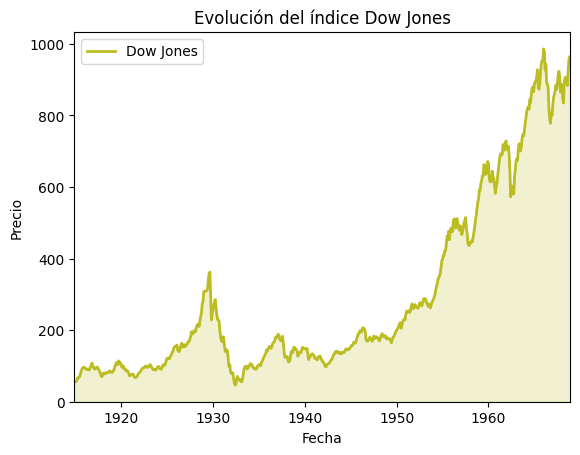

In [21]:
sns.lineplot(data = df_dowjones, x = 'Fecha', y = 'Precio',
             lw = 2,
             color = '#bcbd22',
             label = 'Dow Jones')

plt.xlim(df_dowjones['Fecha'].iloc[0], df_dowjones['Fecha'].iloc[-1])
plt.ylim(0, None)

plt.fill_between(df_dowjones['Fecha'], df_dowjones['Precio'], color = '#bcbd22', alpha=0.2)

plt.legend(loc = 'best')

plt.title('Evolución del índice Dow Jones')

plt.show()

### Histogramas

Filtremos para ver sólo los precios de los diamantes con la peor y la mejor claridad.

In [22]:
df_diamantes3  = df_diamantes[df_diamantes['Claridad'].isin(['I1', 'IF'])]

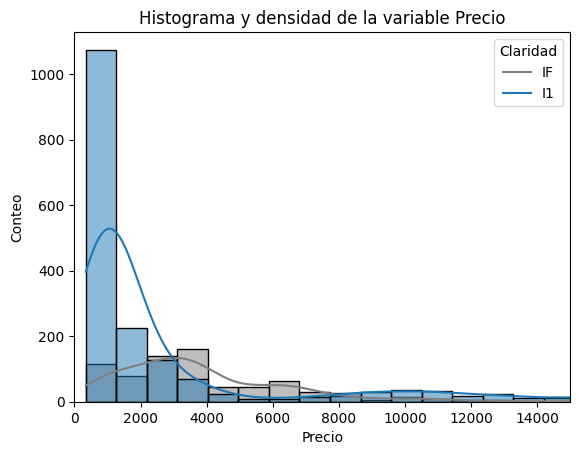

In [23]:
sns.histplot(data = df_diamantes3, x = 'Precio', hue = 'Claridad', bins = 20, kde = True)

plt.xlim(0, 15000)
plt.ylabel('Conteo')
plt.title('Histograma y densidad de la variable Precio')
plt.legend(title = 'Claridad', loc = 'best', labels = ['IF', 'I1'])

plt.show()

### Gráficos de cajas

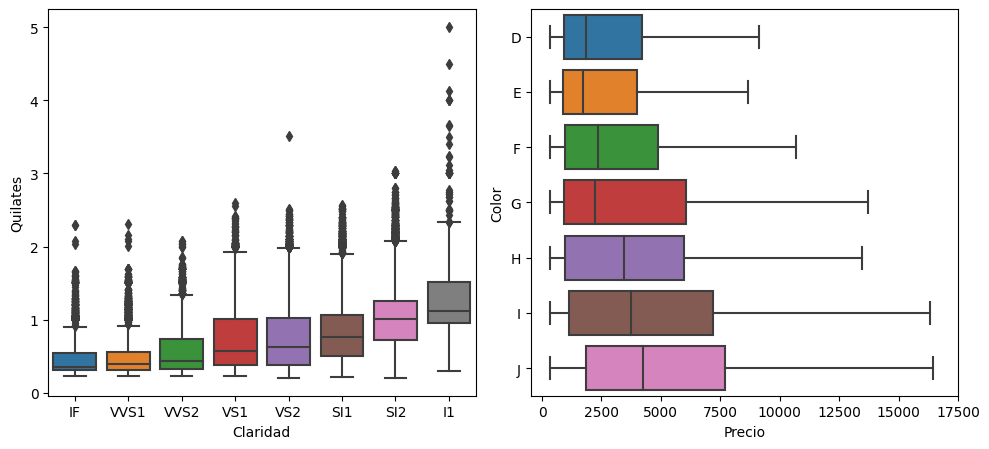

In [24]:
fig, axes = plt.subplots(1, 2, figsize = (10, 4.6))

sns.boxplot(data = df_diamantes, y = 'Quilates', x = 'Claridad', ax = axes[0])

sns.boxplot(data = df_diamantes, y = 'Color', x = 'Precio', orient = 'h', showfliers = False, ax = axes[1])
axes[1].set_xticks(np.arange(0, 18000, 2500))

plt.tight_layout()
plt.show()

### Joinplots

Los joinplots son gráficos muy interesantes en los que combinan un gráfico bivariado con histogramas o gráficos de densidad de cada una de las variables. Vamos a usar el dataset df_creditos para este gráfico. Repasemos las variables.

In [25]:
df_credito.columns

Index(['Edad', 'Ingresos', 'Situacion de vivienda', 'Tiempo de empleo',
       'Tipo de préstamo', 'Grado del préstamo', 'Monto del préstamo',
       'Tasa de interés', 'Estado del préstamo', 'Porcentaje del Ingreso',
       'Default histórico', 'Long. historial crediticio'],
      dtype='object')

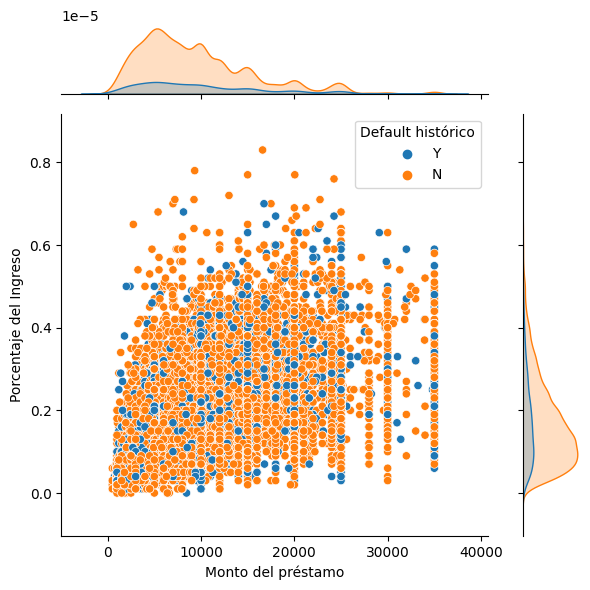

In [26]:
sns.jointplot(data = df_credito, x = 'Monto del préstamo', y = 'Porcentaje del Ingreso', hue = 'Default histórico')

plt.tight_layout()
plt.show()

### Pairplots

Los pairplots son el equivalente se Seaborn de los Scatter matrix de Pandas. Tienen las mismas funciones e idénticos problemas al graficar muchos registros.

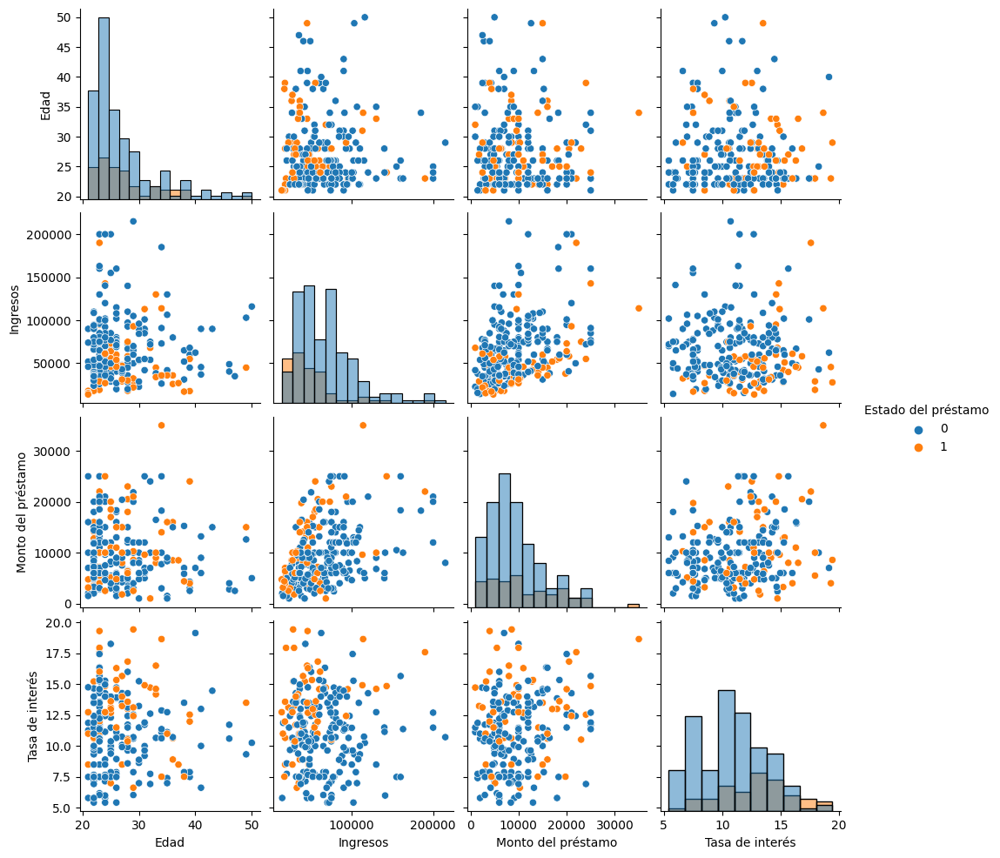

In [27]:
df_credito2 = df_credito[['Edad', 'Ingresos', 'Monto del préstamo', 'Tasa de interés', 'Situacion de vivienda', 'Estado del préstamo', 'Default histórico']].sample(250, random_state = 1)

sns.pairplot(df_credito2, hue = 'Estado del préstamo', diag_kind = "hist")
plt.show()

### Gráficos de violín

Anteriormente vimos que los gráficos de violín cumplen una función similar a los gráficos de caja. En este ocasión, aplicamos el parámetro hue para aplicar una distribución condicional, es decir observamos la distribución de una variable respecto a otra cumpliendo un cierto condicional.

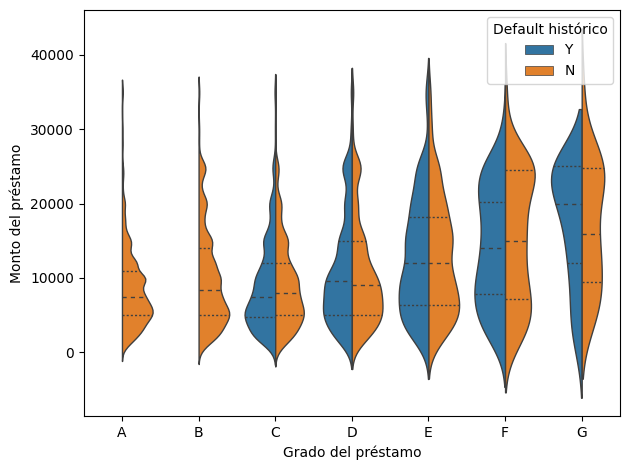

In [28]:
sns.violinplot(data = df_credito, x = 'Grado del préstamo', y = 'Monto del préstamo', hue = 'Default histórico',
               split = True, inner = 'quart', linewidth = 1)

plt.tight_layout()
plt.show()

### Gráficos de calor

Los mapas de calor se usan para visualizar datos en una matriz o tabla en la que los valores se representan mediante colores, útiles para resaltar patrones y relaciones en datos numéricos. En esta clase los vamos a utilizar para visualizar la matriz de correlaciones. Esta matriz se puede calcular rápidamente con el método .corr(). La correlación es un número que va entre -1 y 1. Si la correlación es negativa significa que una variable disminuye cuando la otra aumenta o viceversa.

In [29]:
corr = df_credito.corr(numeric_only = True).round(2)
corr

,Edad,Ingresos,Tiempo de empleo,Monto del préstamo,Tasa de interés,Estado del préstamo,Porcentaje del Ingreso,Long. historial crediticio
Edad,1.00,0.17,0.16,0.05,0.01,-0.02,-0.04,0.86
Ingresos,0.17,1.00,0.13,0.27,0.00,-0.14,-0.25,0.12
Tiempo de empleo,0.16,0.13,1.00,0.11,-0.06,-0.08,-0.05,0.14
Monto del préstamo,0.05,0.27,0.11,1.00,0.15,0.11,0.57,0.04
Tasa de interés,0.01,0.00,-0.06,0.15,1.00,0.34,0.12,0.02
Estado del préstamo,-0.02,-0.14,-0.08,0.11,0.34,1.00,0.38,-0.02
Porcentaje del Ingreso,-0.04,-0.25,-0.05,0.57,0.12,0.38,1.00,-0.03
Long. historial crediticio,0.86,0.12,0.14,0.04,0.02,-0.02,-0.03,1.00


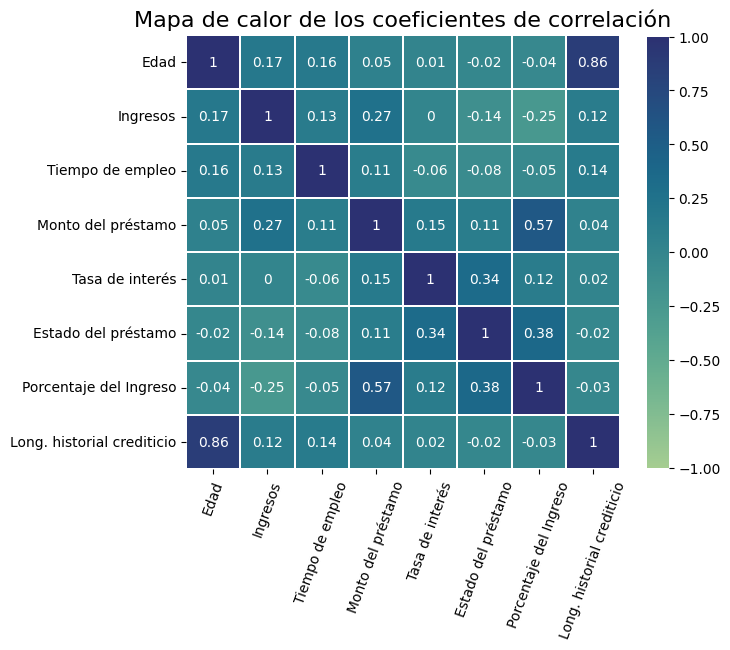

In [30]:
plt.figure(figsize = (7, 7))
sns.heatmap(corr, square = True, annot = True, cmap = sns.color_palette('crest', as_cmap = True), cbar_kws = {'shrink': 0.80},
            vmin=-1, vmax=1, linewidth = .01)

plt.xticks(rotation = 70, fontsize = 10)
plt.yticks(fontsize = 10)

plt.title('Mapa de calor de los coeficientes de correlación', fontsize = 16)
plt.show()

Hay varias coloraciones con las que pueden probar, 'viridis', 'flare, 'crest', etc. Pueden consultarlas en este [enlace](https://seaborn.pydata.org/tutorial/color_palettes.html#).

### Estilos de Seaborn

Al igual como vimos con Matplotlib, también podemos personalizar los gráficos mediante estilos. Esto se puede hace con los métodos set_theme y set_context. Con set_theme podemos cambiar la configuración general por defecto de los gráficos (colores, fondo, tipos de letra, etc.). Por otro lado con set_context podemos podemos modificar rápidamente el tamaño relativo de los elementos que componen un gráfico. Veamos algunos ejemplos de cada uno de ellos.

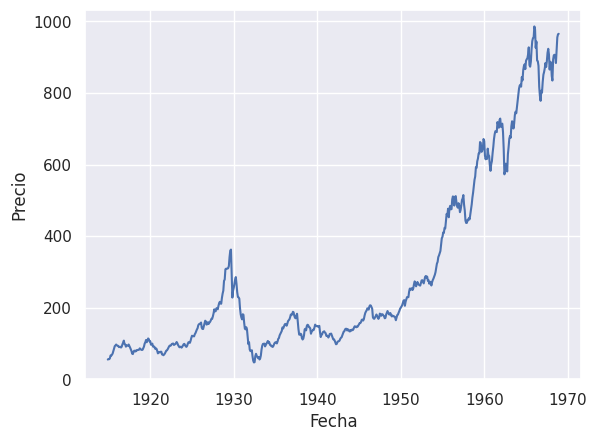

In [31]:
sns.set_theme() # Tema por defecto
sns.lineplot(data = df_dowjones, x = 'Fecha', y = 'Precio')
plt.show()

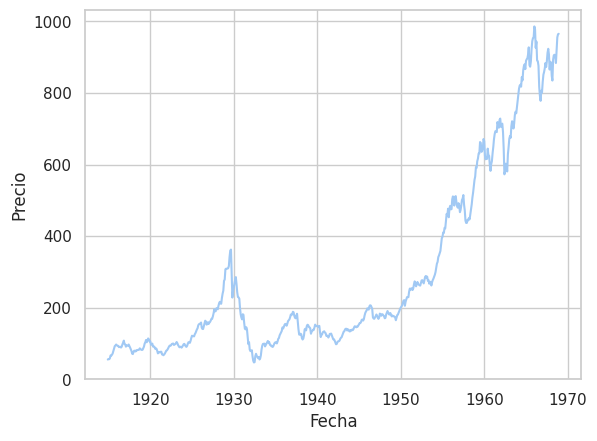

In [32]:
sns.set_theme(style = 'whitegrid', palette = 'pastel')
sns.lineplot(data = df_dowjones, x = 'Fecha', y = 'Precio')
plt.show()

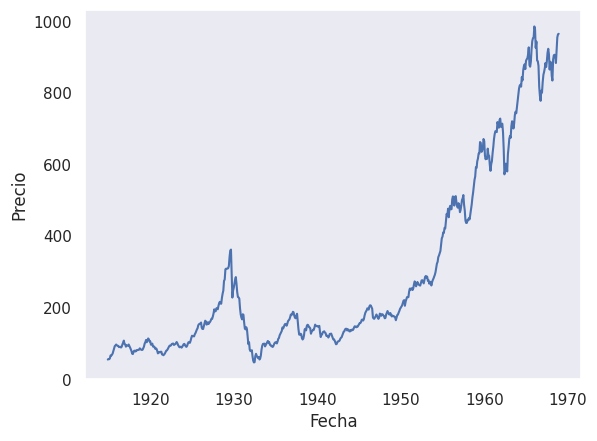

In [33]:
sns.set_theme(style = 'dark', palette = 'deep')
sns.lineplot(data = df_dowjones, x = 'Fecha', y = 'Precio')
plt.show()

Otros estilos son "darkgrid", "white", y "ticks". Configuraciones adicionales de la paleta de colores son "muted", "colorblind", "dark", etc. Más configuraciones se encuentra en la documentación:

* [Estética de las figuras](https://seaborn.pydata.org/tutorial/aesthetics.html)
* [Paleta de colores](https://seaborn.pydata.org/tutorial/color_palettes.html)

Ahora veamos el efecto de set_context.

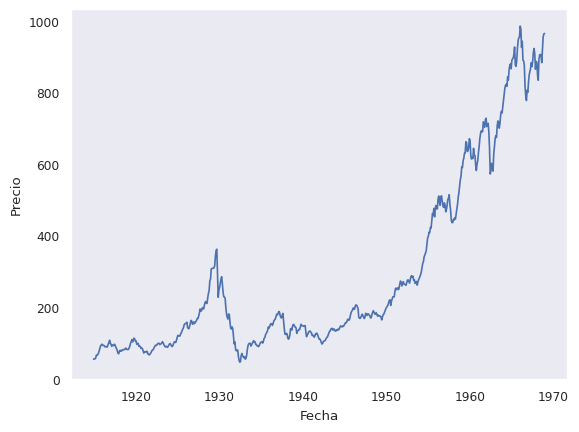

In [34]:
sns.set_context('paper')
sns.lineplot(data = df_dowjones, x = 'Fecha', y = 'Precio')
plt.show()

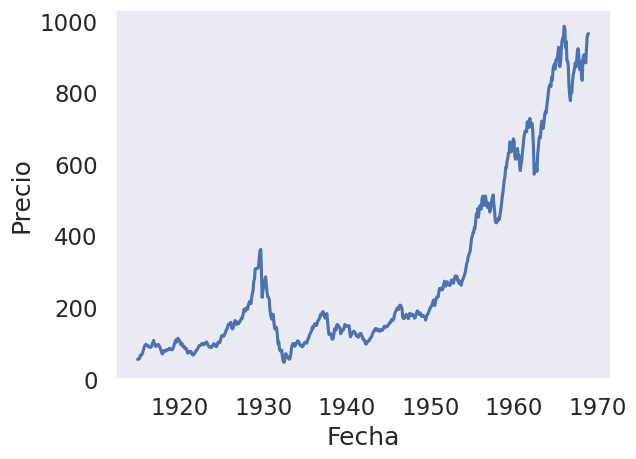

In [35]:
sns.set_context('talk')
sns.lineplot(data = df_dowjones, x = 'Fecha', y = 'Precio')
plt.show()

Hay más configuraciones de set_context, otras son "poster" y "notebook".

In [36]:
plt.style.use('default') # Volvemos a configuración por defecto

## Mapas y gráficos geoespaciales

En esta sección vamos a ver cómo graficar mapas y datos geospaciales. Existen numerosos paquetes no sólo para graficar sino también para tratar con ese tipo de datos. Entre ellos se encuentran: Geopandas, GDAL/OGR, GeoPy, Cartopy, etc. Vamos a usar Geopandas, el cual utilizar Matplotlib para graficar y Shapely para realizar las operaciones en las geometrías. Un tipo de archivo que soporta son los archivos .shp, llamados shapefiles, los cuales son los polígonos con los que se construyen los mapas. Como siempre, siempre es recomendable leer la [documentación](https://geopandas.org/en/stable/index.html#).

Instalemos e importemos Geopandas y otros paquetes que vamos a necesitar.

In [37]:
!pip install geopandas -q
!pip install matplotlib_scalebar -q
!pip install mapclassify -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.8/40.8 kB 1.2 MB/s eta 0:00:00


In [38]:
import geopandas as gpd
from pathlib import Path

Vamos a trabajar con el shapefile de la República Argentina disponible para descargar en la página del [INDEC](https://www.indec.gob.ar/indec/web/Institucional-Indec-Codgeo).

### Carga de archivos shapefile

In [39]:
!wget https://raw.githubusercontent.com/MauriJ/Visualizacion_Bancor/main/Datasets/Argentina/pxpciadatosok.cpg -q
!wget https://raw.githubusercontent.com/MauriJ/Visualizacion_Bancor/main/Datasets/Argentina/pxpciadatosok.dbf -q
!wget https://raw.githubusercontent.com/MauriJ/Visualizacion_Bancor/main/Datasets/Argentina/pxpciadatosok.prj -q
!wget https://raw.githubusercontent.com/MauriJ/Visualizacion_Bancor/main/Datasets/Argentina/pxpciadatosok.qpj -q
!wget https://raw.githubusercontent.com/MauriJ/Visualizacion_Bancor/main/Datasets/Argentina/pxpciadatosok.shp -q
!wget https://raw.githubusercontent.com/MauriJ/Visualizacion_Bancor/main/Datasets/Argentina/pxpciadatosok.shx -q

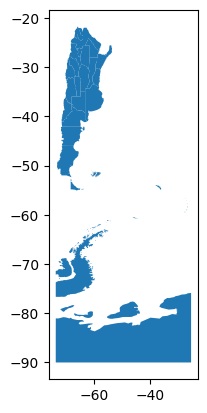

In [40]:
df_arg = gpd.read_file(Path("/content/pxpciadatosok.shp"))
df_arg.plot()
plt.show()

Importemos también datos sobre la Provincia de Córdoba y miremos la estructura de los datos.

In [41]:
!wget https://raw.githubusercontent.com/MauriJ/Visualizacion_Bancor/main/Datasets/Cordoba/Cordoba_con_datos.dbf -q
!wget https://raw.githubusercontent.com/MauriJ/Visualizacion_Bancor/main/Datasets/Cordoba/Cordoba_con_datos.prj -q
!wget https://raw.githubusercontent.com/MauriJ/Visualizacion_Bancor/main/Datasets/Cordoba/Cordoba_con_datos.qpj -q
!wget https://raw.githubusercontent.com/MauriJ/Visualizacion_Bancor/main/Datasets/Cordoba/Cordoba_con_datos.shp -q
!wget https://raw.githubusercontent.com/MauriJ/Visualizacion_Bancor/main/Datasets/Cordoba/Cordoba_con_datos.shx -q

In [42]:
df_cba = gpd.read_file(Path("/content/Cordoba_con_datos.shp"))
df_cba.head()

,toponimo_i,link,varon,mujer,totalpobl,hogares,viviendasp,viv_part_h,geometry
0,336422,141750202,246.0,211.0,457.0,155.0,248.0,151.0,"POLYGON ((3686668.391 6672098.301, 3686892.403..."
1,336421,141470304,211.0,223.0,434.0,125.0,318.0,121.0,"POLYGON ((3651995.370 6492136.442, 3651985.530..."
2,336420,141470302,203.0,168.0,371.0,105.0,117.0,44.0,"POLYGON ((3646477.921 6501399.587, 3646478.283..."
3,336419,140700210,119.0,124.0,243.0,88.0,139.0,86.0,"POLYGON ((3585675.544 6550018.469, 3585800.235..."
4,336418,140280706,142.0,108.0,250.0,79.0,146.0,77.0,"POLYGON ((3590471.687 6560946.389, 3590489.154..."


### Mapas coropléticos

Si graficamos en función de la población de los departamentos de la provincia obtenemos un mapa coroplético. Como lo están viendo estos mapas usan un código de color para prensentar información estadística.

<Figure size 640x480 with 0 Axes>

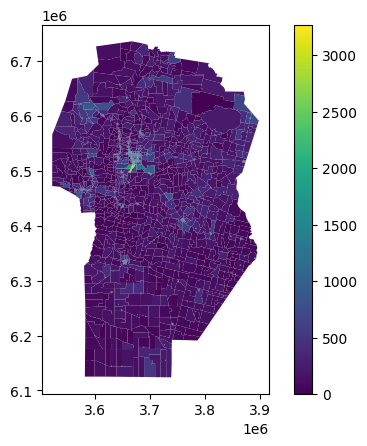

In [43]:
plt.figure()
df_cba.plot(column = "totalpobl", legend = True)
plt.show()

Agrandemos un poco la figura, pero sin distorsionarlo, agreguemos una escala y cambiémosle el color.

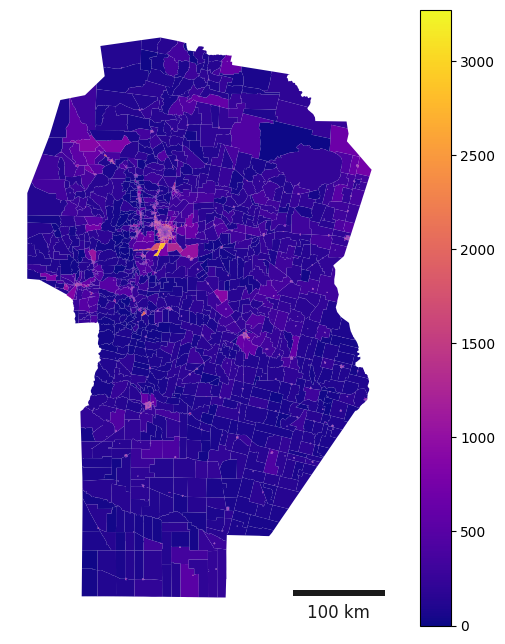

In [44]:
from matplotlib_scalebar.scalebar import ScaleBar

fig, ax = plt.subplots(figsize = (8, 8))
df_cba.plot(column = "totalpobl", legend = True, cmap = 'plasma', ax = ax)
ax.axis("off")

scalebar = ScaleBar(1,
                    box_alpha=0,
                    location="lower right",
                    length_fraction=0.25,
                    font_properties={"size": 12})

ax.set_aspect('equal', adjustable = 'box')

ax.add_artist(scalebar)
plt.show()

### Mapas interactivos

Usando [Folium](https://python-visualization.github.io/folium/latest/) podemos armar mapas interactivos rápidamente simplemente aplicando el método explore().

In [45]:
import folium

df_cba.explore(column = "totalpobl", legend = True, cmap = 'plasma', zoom_start = 7)

### Carga de datos por medio de APIs

La página de datos.gob.ar dispone de una API del Servicio de Normalización de Datos Geográficos de Argentina, con la cual podemos obtener distinta información geográfica de las unidades territoriales del país. Este es el [link](https://datosgobar.github.io/georef-ar-api/).

A continuación usaremos en el ejemplo ofrecido por la API para obtener la ubicación de los aeropuertos y aeródromos del país.

In [46]:
import requests
import urllib

API_BASE_URL = "https://apis.datos.gob.ar/georef/api/"

# Enriquecer coordenadas con las unidades territoriales que las contienen
def get_territorial_units(ubicaciones):
    """Pide las unidades territoriales que contienen a c/punto de una lista de coordenadas."""

    # realiza consulta a la API
    endpoint = "ubicacion"
    data = {
        "ubicaciones": [
            {"lat": ubicacion["lat"], "lon": ubicacion["lon"], "aplanar": True}
            for ubicacion in ubicaciones
    ]}
    url = API_BASE_URL + endpoint

    results = requests.post(
        url, json=data, headers={"Content-Type": "application/json"}
    ).json()

    # convierte a una lista de "resultado más probable" o "vacío" cuando no hay
    parsed_results = [
        single_result[endpoint] if single_result[endpoint] else {}
        for single_result in results["resultados"]
    ]

    return parsed_results

# Enriquecer coordenadas
def add_territorial_units(df, column_lat, column_lon):
    """Agrega unidades territoriales que contienen coordenadas a un DataFrame.

    Args:
        df (pandas.DataFrame): Un DataFrame que tiene coordenadas.
        column_lat (str): Nombre de la columna que tiene latitud.
        column_lon (str): Nombre de la columna que tiene longitud.

    Returns:
        pandas.DataFrame: DataFrame original aumentado con unidades territoriales que contienen a las coordenadas.
    """

    # toma una lista de coordenadas únicas (no repetidas)
    coordinates = df[[column_lon, column_lat]].rename(
        columns={column_lon: "lon", column_lat: "lat"}
    ).drop_duplicates().to_dict("records")

    # crea DataFrame de unidades territoriales que contienen a las coordenadas
    ubicaciones = pd.DataFrame(get_territorial_units(coordinates))

    # agrega las unidades territoriales al DataFrame original
    df_with_territorial_units = df.merge(
        ubicaciones, "left",
        left_on=[column_lon, column_lat],
        right_on=["lon", "lat"]
    )

    # elimina columnas de coordenadas repetidas, dejando las originales
    return df_with_territorial_units.drop(["lon", "lat"], axis=1)

aeropuertos = pd.read_csv("https://servicios.transporte.gob.ar/gobierno_abierto/descargar.php?t=aeropuertos&d=detalle", sep=";")
df_aeropuertos = add_territorial_units(aeropuertos, "longitud", "latitud")

Inspeccionemos en dataframe obtenido.

In [47]:
df_aeropuertos.head()

,local,oaci,iata,tipo,denominacion,coordenadas,latitud,longitud,elev,uom_elev,...,sna,concesionado,provincia,inhab,departamento_id,departamento_nombre,municipio_id,municipio_nombre,provincia_id,provincia_nombre
0,ACB,NaN,NaN,Aeródromo,CORONEL BOGADO/AGROSERVICIOS,"33°16'20""S 60°34'14""W",-60.57066,-33.27226,44.0,Metros,...,NO,NO,SANTA FÉ,NO,82084,Rosario,823393,Coronel Bogado,82,Santa Fe
1,ACH,NaN,NaN,Aeródromo,GENERAL ACHA,"37°24' 6""S 64°36'49""W",-64.61351,-37.40164,277.0,Metros,...,NO,NO,LA PAMPA,NO,42154,Utracán,420133,General Acha,42,La Pampa
2,ACM,NaN,NaN,Aeródromo,ARRECIFES/LA CURA MALAL,"34° 4'33""S 60° 8'30""W",-60.14170,-34.07574,37.0,Metros,...,NO,NO,BUENOS AIRES,NO,06077,Arrecifes,060077,Arrecifes,06,Buenos Aires
3,ADO,SAWD,PUD,Aeródromo,PUERTO DESEADO,"47°44' 6""S 65°54'15""W",-65.90410,-47.73511,82.0,Metros,...,NO,NO,SANTA CRUZ,NO,78014,Deseado,None,None,78,Santa Cruz
4,ADT,NaN,NaN,Aeródromo,BANDERA/AGROSERVICIOS DOÑA TERESA,"28°51'19""S 62°15'53""W",-62.26462,-28.85541,75.0,Metros,...,NO,NO,SANTIAGO DEL ESTERO,NO,86077,General Taboada,None,None,86,Santiago del Estero


Vamos a unirlo al dataframe que ya habiamos importado sobre Argentina. Para ello unifiquemos el nombre de la variable que aloja el nombre de las provincias y el nombre de las provincias mismas.

In [48]:
df_arg.head()

,link,provincia,mujeres,varones,personas,hogares,viv_part,viv_part_h,geometry
0,02,Ciudad Autónoma de Buenos Aires,1560470,1329681,2890151,1150134,1423973,1082998,"POLYGON ((-58.42483 -34.66387, -58.42499 -34.6..."
1,10,Catamarca,185519,182309,367828,96001,113634,89376,"POLYGON ((-65.81854 -27.82801, -65.81765 -27.8..."
2,14,Córdoba,1703788,1605088,3308876,1031843,1232211,978553,"POLYGON ((-63.39267 -34.53116, -63.39268 -34.5..."
3,18,Corrientes,507520,485075,992595,267797,292644,248844,"POLYGON ((-57.62144 -30.17781, -57.62453 -30.1..."
4,22,Chaco,535309,519950,1055259,288422,312602,270133,"POLYGON ((-58.86673 -27.47413, -58.87371 -27.4..."


In [49]:
df_arg = df_arg.rename(columns = {"provincia": "provincia_nombre"})

In [50]:
df_aeropuertos['provincia_nombre'].unique()

array(['Santa Fe', 'La Pampa', 'Buenos Aires', 'Santa Cruz',
       'Santiago del Estero', 'Ciudad Autónoma de Buenos Aires',
       'Neuquén', 'Córdoba', 'San Juan', 'Río Negro', 'Entre Ríos',
       'Catamarca', 'Misiones', 'Chubut', 'Corrientes', 'Salta',
       'Tucumán', 'San Luis', 'Chaco', 'Jujuy', 'Mendoza',
       'Tierra del Fuego, Antártida e Islas del Atlántico Sur', 'Formosa',
       'La Rioja', None], dtype=object)

In [51]:
df_arg['provincia_nombre'].unique()

array(['Ciudad Autónoma de Buenos Aires', 'Catamarca', 'Córdoba',
       'Corrientes', 'Chaco', 'Entre Ríos', 'Formosa', 'Jujuy',
       'La Pampa', 'La Rioja', 'Mendoza', 'Misiones', 'Neuquén',
       'Río Negro', 'Salta', 'San Juan', 'San Luis', 'Santa Fe',
       'Santiago del Estero', 'Tucumán', 'Santa Cruz', 'Buenos Aires',
       'Chubut', 'Tierra del Fuego'], dtype=object)

In [52]:
df_arg.loc[df_arg['provincia_nombre'] == 'Tierra del Fuego', 'provincia_nombre'] = 'Tierra del Fuego, Antártida e Islas del Atlántico Sur'
df_arg['provincia_nombre'].unique()

array(['Ciudad Autónoma de Buenos Aires', 'Catamarca', 'Córdoba',
       'Corrientes', 'Chaco', 'Entre Ríos', 'Formosa', 'Jujuy',
       'La Pampa', 'La Rioja', 'Mendoza', 'Misiones', 'Neuquén',
       'Río Negro', 'Salta', 'San Juan', 'San Luis', 'Santa Fe',
       'Santiago del Estero', 'Tucumán', 'Santa Cruz', 'Buenos Aires',
       'Chubut', 'Tierra del Fuego, Antártida e Islas del Atlántico Sur'],
      dtype=object)

Unamos ambos datasets, haciendo "merge" en la variable "provincia_nombre".

In [53]:
df_arg = df_arg.merge(df_aeropuertos, on = ["provincia_nombre"], how = "inner")

Hagamos un mapa interactivo con todos los aeropuertos del país.

In [54]:
m = folium.Map(location=[df_arg.longitud.mean(), df_arg.latitud.mean()], zoom_start = 5)

for index, row in df_arg.iterrows():
    folium.Marker((row['longitud'],row['latitud']), popup=row["denominacion"]).add_to(m)

m

Y ahora con sólo los de Córdoba.

In [55]:
m = folium.Map(location=[df_arg.longitud.mean(), df_arg.latitud.mean()], zoom_start = 5)

for index, row in df_arg[df_arg.provincia_nombre == 'Córdoba'].iterrows():
    folium.Marker((row['longitud'],row['latitud']), popup=row["denominacion"]).add_to(m)

m

## Actividad práctica

Usando el dataset [Tips](https://rdrr.io/cran/reshape2/man/tips.html) de Seaborn hacer una suerte de mini análisis exploratorio, incluir:

1. Gráfico de puntos.
2. Histogramas.
3. Scatter matrix / pairplot.

Descargar algún shapefile de la página de [INDEC](https://www.indec.gob.ar/indec/web/Institucional-Indec-Codgeo) y hacer algún mapa, mapa coroplético o mapa interactivo.



In [56]:
df_tips = sns.load_dataset('tips')
df_tips.head()

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4
